# Trabalho Final

Alunos:
- Ítalo Cezar Eugênio de Santana(UC22102126)
- Jairo Pereira de Sousa Júnior(UC22101494)

# Sobre nossa base

### Descrição da Base de Dados e Limpeza Inicial

Neste trabalho, utilizaremos uma base de dados contendo informações sobre a arrecadação de impostos e contribuições federais administrados pela Secretaria Especial da Receita Federal do Brasil (RFB). Esta base de dados é crucial para entender o comportamento da arrecadação fiscal no Brasil e realizar análises financeiras e econômicas detalhadas.

#### Limpeza Manual dos Dados

Antes de proceder com a análise exploratória e a modelagem dos dados, realizamos uma série de etapas de limpeza manual para garantir a qualidade e a integridade dos dados. A seguir, descrevemos as principais ações de limpeza realizadas:

1. **Eliminação de Colunas Desnecessárias**:
   - Algumas colunas que não eram relevantes para nossa análise foram eliminadas da base de dados. Isso ajudou a simplificar o dataset e a focar nas informações mais pertinentes.

2. **Substituição de Delimitadores**:
   - Observamos que os delimitadores dos dados estavam inconsistentes, com vírgulas (`,`) sendo usadas em vez de pontos e vírgulas (`;`). Corrigimos esse problema substituindo as vírgulas pelos pontos e vírgulas apropriados, garantindo uma leitura correta dos dados.

3. **Correção de Tipos de Dados**:
   - Identificamos que várias colunas que deveriam conter valores numéricos estavam sendo interpretadas como texto (tipo `object`). Isso estava causando erros nas análises.
   - Para resolver isso, manualmente extraímos e convertemos os valores dessas colunas para o tipo `float`. Esta transformação foi essencial para permitir cálculos e análises precisas.

Essas etapas de limpeza foram fundamentais para preparar os dados para a análise exploratória inicial e subsequente modelagem preditiva. Com os dados devidamente limpos e estruturados, estamos agora prontos para proceder com uma análise detalhada e tirar insights significativos sobre a arrecadação de impostos e contribuições federais no Brasil.


Link: https://dados.gov.br/dados/conjuntos-dados/resultado-da-arrecadacao

In [2]:
from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'google'

In [ ]:
#posicionando no diretório dados
%pwd
%cd drive
%cd My Drive
%pwd

# Bibliotecas necessárias:

Neste trabalho de Data Science, utilizaremos diversas bibliotecas essenciais para realizar análises de dados, visualizações e modelagem preditiva.

In [ ]:
!pip install ydata_profiling

In [18]:
import numpy as np
import math
import random
import pandas as pd
import scipy.stats as stat
import seaborn as sns
import os
import pandas
import sklearn
import ydata_profiling
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import load_breast_cancer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error,silhouette_score
from sklearn.cluster import KMeans

from sklearn.ensemble import RandomForestRegressor 
from sklearn.linear_model import LinearRegression


# Carga Correta dos Dados e Análise Exploratória Inicial: 10%
- Head
- Info
- Describe
- Quantidade de nulos e etc

In [19]:
# Configurações do seaborn
sns.set(color_codes=True)
sns.set_palette(sns.color_palette("muted"))

# Caminho do arquivo
arquivo = os.path.join('dados', '_Novas Tecnologias - Arrecadação por UF.csv')

# Leitura dos dados
dados = pd.read_csv(arquivo)

# Lista das colunas numéricas
colunas_numericas = [
    'IMPOSTO SOBRE IMPORTAÇÃO', 'IMPOSTO SOBRE EXPORTAÇÃO', 'IPI - FUMO',
    'IPI - BEBIDAS', 'IPI - AUTOMÓVEIS', 'IPI - VINCULADO À IMPORTACAO',
    'IPI - OUTROS', 'IRPF', 'IRPJ - ENTIDADES FINANCEIRAS',
    'IRPJ - DEMAIS EMPRESAS', 'IRRF - RENDIMENTOS DO TRABALHO',
    'IRRF - RENDIMENTOS DO CAPITAL', 'IRRF - REMESSAS P/ EXTERIOR',
    'IRRF - OUTROS RENDIMENTOS', 'IMPOSTO S/ OPERAÇÕES FINANCEIRAS',
    'IMPOSTO TERRITORIAL RURAL', 'CPMF', 'COFINS'
]

# Filtra as colunas que existem no dataset
colunas_numericas_ajustadas = [coluna for coluna in colunas_numericas if coluna in dados.columns]

# Converte as colunas numéricas de string para float
for coluna in colunas_numericas_ajustadas:
    dados[coluna] = pd.to_numeric(dados[coluna].astype(str).str.replace('.', '', regex=False).str.replace(',', '.', regex=False), errors='coerce')

# Cria uma nova coluna para o total arrecadado
dados['TOTAL_ARRECADADO'] = dados[colunas_numericas_ajustadas].sum(axis=1)



In [5]:
#Utilização do método head() para visualizar as primeiras linhas do dataset e entender sua estrutura básica.
dados.head()

,Ano,Mês,UF,IMPOSTO SOBRE IMPORTAÇÃO,IMPOSTO SOBRE EXPORTAÇÃO,IPI - FUMO,IPI - BEBIDAS,IPI - AUTOMÓVEIS,IPI - VINCULADO À IMPORTACAO,IPI - OUTROS,...,IRPJ - DEMAIS EMPRESAS,IRRF - RENDIMENTOS DO TRABALHO,IRRF - RENDIMENTOS DO CAPITAL,IRRF - REMESSAS P/ EXTERIOR,IRRF - OUTROS RENDIMENTOS,IMPOSTO S/ OPERAÇÕES FINANCEIRAS,IMPOSTO TERRITORIAL RURAL,CPMF,COFINS,TOTAL_ARRECADADO
0,2000,Janeiro,AC,231.0,0.0,292096.0,0.0,0.0,167.0,1558.0,...,676835.0,1084940.0,27652.0,570.0,30894.0,1220.0,28447.0,103.0,1770475.0,4093028.0
1,2000,Janeiro,AL,475088.0,33873.0,1329338.0,812470.0,0.0,141735.0,3676847.0,...,2672106.0,4454947.0,544056.0,191382.0,309573.0,26939.0,4252539.0,97248.0,7493570.0,26973076.0
2,2000,Janeiro,AM,11679405.0,0.0,1507146.0,1791471.0,27796.0,4414483.0,1800346.0,...,10058713.0,10174718.0,1241708.0,3580022.0,1029164.0,843881.0,40171.0,832562.0,44000981.0,93814018.0
3,2000,Janeiro,AP,24267.0,0.0,424862.0,1419.0,321.0,22333.0,12165.0,...,586572.0,1444486.0,205031.0,5825.0,34602.0,6999.0,6477.0,0.0,1682102.0,4640822.0
4,2000,Janeiro,BA,10476457.0,13.0,5542123.0,11533707.0,0.0,7496476.0,23743858.0,...,25695696.0,27277025.0,13374802.0,2302766.0,2022200.0,1218485.0,2446535.0,11923442.0,81027229.0,228756839.0


In [7]:
# Utilização do método info() para obter informações sobre o tipo de dados em cada coluna, número de entradas não nulas e uso de memória.
dados.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7857 entries, 0 to 7856
Data columns (total 22 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Ano                               7857 non-null   int64  
 1   Mês                               7857 non-null   object 
 2   UF                                7857 non-null   object 
 3   IMPOSTO SOBRE IMPORTAÇÃO          7576 non-null   float64
 4   IMPOSTO SOBRE EXPORTAÇÃO          7812 non-null   float64
 5   IPI - FUMO                        7565 non-null   float64
 6   IPI - BEBIDAS                     7565 non-null   float64
 7   IPI - AUTOMÓVEIS                  7742 non-null   float64
 8   IPI - VINCULADO À IMPORTACAO      7618 non-null   float64
 9   IPI - OUTROS                      7596 non-null   float64
 10  IRPF                              7553 non-null   float64
 11  IRPJ - ENTIDADES FINANCEIRAS      7710 non-null   float64
 12  IRPJ -

In [8]:
#  Utilização do método describe() para gerar estatísticas descritivas resumidas dos dados numéricos, como média, desvio padrão, mínimo, quartis e máximo.
dados.describe()

,Ano,IMPOSTO SOBRE IMPORTAÇÃO,IMPOSTO SOBRE EXPORTAÇÃO,IPI - FUMO,IPI - BEBIDAS,IPI - AUTOMÓVEIS,IPI - VINCULADO À IMPORTACAO,IPI - OUTROS,IRPF,IRPJ - ENTIDADES FINANCEIRAS,IRPJ - DEMAIS EMPRESAS,IRRF - RENDIMENTOS DO TRABALHO,IRRF - RENDIMENTOS DO CAPITAL,IRRF - REMESSAS P/ EXTERIOR,IRRF - OUTROS RENDIMENTOS,IMPOSTO S/ OPERAÇÕES FINANCEIRAS,IMPOSTO TERRITORIAL RURAL,CPMF,COFINS,TOTAL_ARRECADADO
count,7857.000000,7.576000e+03,7.812000e+03,7.565000e+03,7.565000e+03,7.742000e+03,7.618000e+03,7.596000e+03,7.553000e+03,7.710000e+03,7.476000e+03,7.482000e+03,7.641000e+03,7.674000e+03,7.640000e+03,7.695000e+03,7.796000e+03,7.619000e+03,7.405000e+03,7.857000e+03
mean,2011.628866,8.843170e+07,6.410363e+05,1.231726e+07,7.692383e+06,1.140088e+07,4.120797e+07,5.724626e+07,7.668695e+07,4.816696e+07,3.261268e+08,2.567637e+08,1.247459e+08,6.241393e+07,2.635833e+07,7.904617e+07,3.093999e+06,2.216815e+07,1.387076e+07,1.210475e+09
std,7.001653,2.602518e+08,2.171724e+07,5.284756e+07,1.416290e+07,3.425511e+07,1.049299e+08,1.638917e+08,2.257140e+08,2.313112e+08,1.041055e+09,6.953243e+08,5.637184e+08,2.987107e+08,8.146630e+07,3.376787e+08,1.594648e+07,1.537094e+08,1.063520e+08,3.539161e+09
min,2000.000000,-5.915950e+05,-3.379762e+06,-4.329186e+07,-1.079723e+07,-5.424603e+06,0.000000e+00,-3.485777e+06,1.036410e+02,-8.099953e+06,3.037600e+02,-7.471250e+07,-1.872138e+08,-2.590460e+08,-2.555620e+06,-2.689010e+05,-1.775623e+07,-3.496452e+06,0.000000e+00,-4.598430e+06
25%,2006.000000,1.455566e+05,0.000000e+00,0.000000e+00,3.581455e+05,0.000000e+00,9.084081e+04,1.293855e+06,4.329092e+06,3.170477e+03,1.226223e+07,1.105071e+07,6.550850e+05,1.094368e+05,7.573428e+05,1.799975e+05,7.161761e+04,0.000000e+00,0.000000e+00,3.475354e+07
50%,2012.000000,4.568057e+06,3.243250e+02,2.012356e+04,2.732534e+06,2.374140e+03,1.768570e+06,4.220059e+06,1.560704e+07,2.349612e+05,4.692312e+07,3.634489e+07,3.405593e+06,1.438582e+06,2.841787e+06,1.802837e+06,2.655685e+05,0.000000e+00,0.000000e+00,1.499801e+08
75%,2018.000000,6.108894e+07,8.588267e+03,1.744235e+06,8.547034e+06,6.533904e+05,3.334958e+07,4.223042e+07,5.183784e+07,8.159727e+06,1.986015e+08,1.275928e+08,2.273274e+07,1.189903e+07,1.126595e+07,1.164796e+07,1.086750e+06,1.137684e+05,0.000000e+00,6.902583e+08
max,2024.000000,2.795288e+09,1.206944e+09,8.944776e+08,1.456451e+08,3.476686e+08,1.152147e+09,1.666053e+09,5.299245e+09,7.729619e+09,2.293867e+10,9.756350e+09,1.446338e+10,6.713613e+09,9.338009e+08,3.763449e+09,3.751499e+08,2.332493e+09,2.299033e+09,5.926420e+10


In [9]:
# Quantidade de Valores Nulos: Identificação e contagem de valores nulos em cada coluna para avaliar a qualidade dos dados e a necessidade de tratamento de dados faltantes.
dados.isnull().sum().sum(0)

4261

# Correção de problemas da base (conversão de tipos, eliminação de dados faltantes, etc) : 10%

In [4]:
dados_ano = dados.groupby('Ano')[colunas_numericas_ajustadas + ['TOTAL_ARRECADADO']].sum().reset_index()

/var/folders/pr/pwdqpc7d4vgdkqyjfzcgrv_r0000gq/T/ipykernel_25438/3797195261.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=dados_ano, x='Ano', y='TOTAL_ARRECADADO', palette='muted')


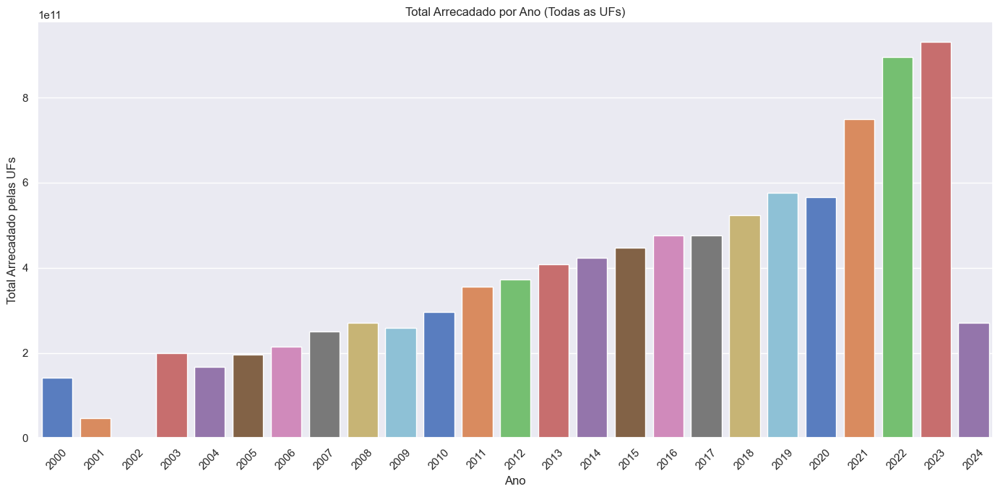

In [5]:
plt.figure(figsize=(14, 7))
sns.barplot(data=dados_ano, x='Ano', y='TOTAL_ARRECADADO', palette='muted')
plt.title('Total Arrecadado por Ano (Todas as UFs)')
plt.xlabel('Ano')
plt.ylabel('Total Arrecadado pelas UFs')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Quantidade de aparições

In [15]:
dados.Mês.value_counts()

Mês
Janeiro      675
Fevereiro    675
Março        675
Abril        648
Maio         648
Junho        648
Julho        648
Agosto       648
Setembro     648
Outubro      648
Novembro     648
Dezembro     648
Name: count, dtype: int64

In [7]:
dados[dados.isnull().any(axis=1)]

,Ano,Mês,UF,IMPOSTO SOBRE IMPORTAÇÃO,IMPOSTO SOBRE EXPORTAÇÃO,IPI - FUMO,IPI - BEBIDAS,IPI - AUTOMÓVEIS,IPI - VINCULADO À IMPORTACAO,IPI - OUTROS,...,IRPJ - DEMAIS EMPRESAS,IRRF - RENDIMENTOS DO TRABALHO,IRRF - RENDIMENTOS DO CAPITAL,IRRF - REMESSAS P/ EXTERIOR,IRRF - OUTROS RENDIMENTOS,IMPOSTO S/ OPERAÇÕES FINANCEIRAS,IMPOSTO TERRITORIAL RURAL,CPMF,COFINS,TOTAL_ARRECADADO
342,2001,Janeiro,RJ,NaN,14.000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,216.648,NaN,NaN,2.306480e+02
343,2001,Janeiro,RN,NaN,0.000,NaN,NaN,0.0,6.589250e+02,9.758230e+02,...,NaN,NaN,NaN,7.326950e+02,4.120760e+02,3.525900e+01,28.530,8.379600e+01,NaN,4.334311e+03
344,2001,Janeiro,RS,NaN,819.492,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,621.061,NaN,NaN,1.440553e+03
345,2001,Janeiro,RO,1.241070e+02,0.000,6.690000e+02,0.0,32.0,5.676900e+01,1.221190e+02,...,NaN,NaN,3.150340e+02,1.520000e+02,1.364350e+02,7.714000e+00,174.812,1.407670e+02,NaN,2.285262e+03
346,2001,Janeiro,RR,6.400000e+01,0.000,2.829110e+02,0.0,0.0,5.244000e+00,2.396000e+00,...,NaN,6.616010e+02,1.212120e+02,0.000000e+00,3.345500e+01,0.000000e+00,11.846,5.381000e+00,NaN,1.347009e+03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,2004,Janeiro,PR,6.113739e+07,241977.000,0.000000e+00,6144292.0,15540393.0,2.202555e+07,3.106704e+07,...,153142717.0,6.599893e+07,1.344162e+08,5.997938e+06,1.153495e+07,1.548263e+07,594493.000,9.809687e+07,NaN,6.482514e+08
1312,2004,Janeiro,PE,9.801585e+06,0.000,6.454637e+06,14221570.0,0.0,6.507476e+06,1.116796e+07,...,43731934.0,2.819124e+07,1.367337e+07,1.237658e+06,2.839375e+06,1.033602e+06,277095.000,3.349592e+06,NaN,1.494008e+08
1313,2004,Janeiro,PI,8.348000e+03,0.000,7.857780e+05,2830858.0,0.0,1.164000e+03,3.354850e+05,...,5196799.0,3.838046e+06,1.245318e+07,6.435000e+03,2.848460e+05,9.187200e+04,156064.000,2.268320e+05,NaN,2.675960e+07
1314,2004,Janeiro,RJ,4.893447e+07,58960.000,2.543280e+07,31333459.0,8955649.0,2.896256e+07,4.526383e+07,...,801856231.0,4.880196e+08,3.888560e+08,9.039044e+07,4.187940e+07,2.864793e+07,440938.000,4.840341e+07,NaN,2.339294e+09


In [8]:
# Proporçãode dados faltantes
proporcaoDadosFaltantes = (dados.isnull().sum()/len(dados))
proporcaoDadosFaltantes

Ano                                 0.000000
Mês                                 0.000000
UF                                  0.000000
IMPOSTO SOBRE IMPORTAÇÃO            0.035764
IMPOSTO SOBRE EXPORTAÇÃO            0.005727
IPI - FUMO                          0.037164
IPI - BEBIDAS                       0.037164
IPI - AUTOMÓVEIS                    0.014637
IPI - VINCULADO À IMPORTACAO        0.030419
IPI - OUTROS                        0.033219
IRPF                                0.038692
IRPJ - ENTIDADES FINANCEIRAS        0.018709
IRPJ - DEMAIS EMPRESAS              0.048492
IRRF - RENDIMENTOS DO TRABALHO      0.047728
IRRF - RENDIMENTOS DO CAPITAL       0.027491
IRRF - REMESSAS P/ EXTERIOR         0.023291
IRRF - OUTROS RENDIMENTOS           0.027619
IMPOSTO S/ OPERAÇÕES FINANCEIRAS    0.020619
IMPOSTO TERRITORIAL RURAL           0.007764
CPMF                                0.030291
COFINS                              0.057528
TOTAL_ARRECADADO                    0.000000
dtype: flo

In [9]:
print(sum(proporcaoDadosFaltantes == 0))
print(dados.columns[proporcaoDadosFaltantes == 0])

4
Index(['Ano', 'Mês', 'UF', 'TOTAL_ARRECADADO'], dtype='object')


In [21]:
dados = dados.dropna()

In [11]:
dados.isnull().sum()

Ano                                 0
Mês                                 0
UF                                  0
IMPOSTO SOBRE IMPORTAÇÃO            0
IMPOSTO SOBRE EXPORTAÇÃO            0
IPI - FUMO                          0
IPI - BEBIDAS                       0
IPI - AUTOMÓVEIS                    0
IPI - VINCULADO À IMPORTACAO        0
IPI - OUTROS                        0
IRPF                                0
IRPJ - ENTIDADES FINANCEIRAS        0
IRPJ - DEMAIS EMPRESAS              0
IRRF - RENDIMENTOS DO TRABALHO      0
IRRF - RENDIMENTOS DO CAPITAL       0
IRRF - REMESSAS P/ EXTERIOR         0
IRRF - OUTROS RENDIMENTOS           0
IMPOSTO S/ OPERAÇÕES FINANCEIRAS    0
IMPOSTO TERRITORIAL RURAL           0
CPMF                                0
COFINS                              0
TOTAL_ARRECADADO                    0
dtype: int64

In [ ]:
dados.isnull().sum().sum(0)

0

In [ ]:
dados.dtypes

Ano                                   int64
Mês                                  object
UF                                   object
IMPOSTO SOBRE IMPORTAÇÃO            float64
IMPOSTO SOBRE EXPORTAÇÃO            float64
IPI - FUMO                          float64
IPI - BEBIDAS                       float64
IPI - AUTOMÓVEIS                    float64
IPI - VINCULADO À IMPORTACAO        float64
IPI - OUTROS                        float64
IRPF                                float64
IRPJ - ENTIDADES FINANCEIRAS        float64
IRPJ - DEMAIS EMPRESAS              float64
IRRF - RENDIMENTOS DO TRABALHO      float64
IRRF - RENDIMENTOS DO CAPITAL       float64
IRRF - REMESSAS P/ EXTERIOR         float64
IRRF - OUTROS RENDIMENTOS           float64
IMPOSTO S/ OPERAÇÕES FINANCEIRAS    float64
IMPOSTO TERRITORIAL RURAL           float64
CPMF                                float64
COFINS                              float64
TOTAL_ARRECADADO                    float64
dtype: object

# Profiling: 10%

In [3]:
perfil = ydata_profiling.ProfileReport(dados)
perfil.to_widgets()
perfil.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/ydata_profiling/model/correlations.py:66: UserWarning: There was an attempt to calculate the auto correlation, but this failed.
To hide this warning, disable the calculation
(using `df.profile_report(correlations={"auto": {"calculate": False}})`
If this is problematic for your use case, please report this as an issue:
https://github.com/ydataai/ydata-profiling/issues
(include the error message: 'could not convert string to float: 'Janeiro'')
  warnings.warn(


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#Gera o html do profilling 
perfil.to_file("relatorioProfilingArrecadacaoPorUF.html")

NameError: name 'perfil' is not defined

Link para acessar o profiling hospedado 

In [ ]:
#https://impostos-profiling.netlify.app

In [ ]:
dados.head()

,Ano,Mês,UF,IMPOSTO SOBRE IMPORTAÇÃO,IMPOSTO SOBRE EXPORTAÇÃO,IPI - FUMO,IPI - BEBIDAS,IPI - AUTOMÓVEIS,IPI - VINCULADO À IMPORTACAO,IPI - OUTROS,...,IRPJ - DEMAIS EMPRESAS,IRRF - RENDIMENTOS DO TRABALHO,IRRF - RENDIMENTOS DO CAPITAL,IRRF - REMESSAS P/ EXTERIOR,IRRF - OUTROS RENDIMENTOS,IMPOSTO S/ OPERAÇÕES FINANCEIRAS,IMPOSTO TERRITORIAL RURAL,CPMF,COFINS,TOTAL_ARRECADADO
0,2000,Janeiro,AC,231.0,0.0,292096.0,0.0,0.0,167.0,1558.0,...,676835.0,1084940.0,27652.0,570.0,30894.0,1220.0,28447.0,103.0,1770475.0,4093028.0
1,2000,Janeiro,AL,475088.0,33873.0,1329338.0,812470.0,0.0,141735.0,3676847.0,...,2672106.0,4454947.0,544056.0,191382.0,309573.0,26939.0,4252539.0,97248.0,7493570.0,26973076.0
2,2000,Janeiro,AM,11679405.0,0.0,1507146.0,1791471.0,27796.0,4414483.0,1800346.0,...,10058713.0,10174718.0,1241708.0,3580022.0,1029164.0,843881.0,40171.0,832562.0,44000981.0,93814018.0
3,2000,Janeiro,AP,24267.0,0.0,424862.0,1419.0,321.0,22333.0,12165.0,...,586572.0,1444486.0,205031.0,5825.0,34602.0,6999.0,6477.0,0.0,1682102.0,4640822.0
4,2000,Janeiro,BA,10476457.0,13.0,5542123.0,11533707.0,0.0,7496476.0,23743858.0,...,25695696.0,27277025.0,13374802.0,2302766.0,2022200.0,1218485.0,2446535.0,11923442.0,81027229.0,228756839.0


# Estatística descritiva com apresentação de gráficos relevantes (usar matplotlib E seaborn) : 30%

In [ ]:
# Filtrando a UF
uf_especifica = 'DF' 
dados_uf = dados[dados['UF'] == uf_especifica]

# Agrupa os dados por 'Ano' e soma as colunas numéricas
dados_uf_ano = dados_uf.groupby('Ano')[colunas_numericas_ajustadas + ['TOTAL_ARRECADADO']].sum().reset_index()

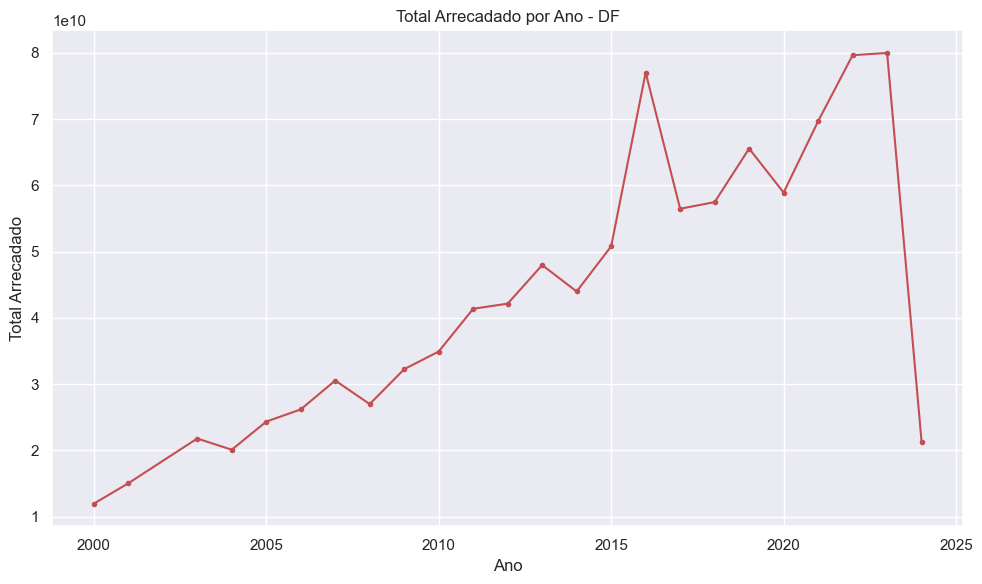

In [ ]:
# Plotando o gráfico
plt.subplots(figsize=(10, 6))
plt.plot(dados_uf_ano['Ano'], dados_uf_ano['TOTAL_ARRECADADO'], 'r.-')
plt.xlabel('Ano')
plt.ylabel('Total Arrecadado')
plt.title(f'Total Arrecadado por Ano - {uf_especifica}')
plt.grid(True)
plt.tight_layout()
plt.show()

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/relational.py:438: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  points = ax.scatter(x=x, y=y, **kws)


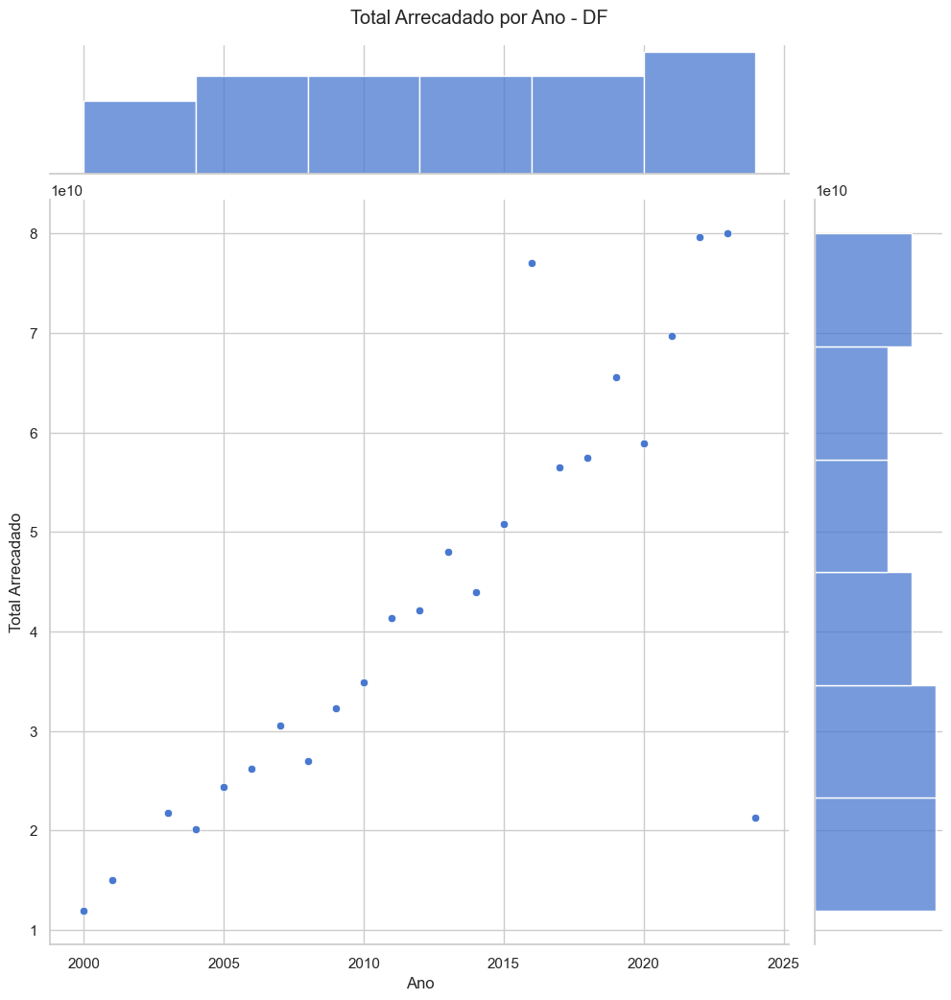

In [ ]:
figsize = (10, 6)

# Extraindo os valores para o gráfico
cd_ = dados_uf_ano[['Ano', 'TOTAL_ARRECADADO']].values

# Cria o gráfico de dispersão com distribuições marginais
with sns.axes_style("whitegrid"):
    g = sns.jointplot(x=cd_[:, 0], y=cd_[:, 1], height=figsize[0], kind="scatter", cmap="viridis")
    g.set_axis_labels('Ano', 'Total Arrecadado')
    plt.suptitle(f'Total Arrecadado por Ano - {uf_especifica}', y=1.02)

plt.show()

# Machine Learning com justificativas do objetivo e avaliação dos resultados (clusterização ou classificação): 30%

# Predict de quanto as UFs irão arrecadar em 2025

In [5]:
# Cria uma nova coluna para o total arrecadado
dados['TOTAL_ARRECADADO'] = dados[colunas_numericas_ajustadas].sum(axis=1)

# Filtrando colunas de interesse
dados_interesse = ['Ano', 'UF'] + colunas_numericas_ajustadas + ['TOTAL_ARRECADADO']

# Selecionando apenas colunas de interesse
dados = dados[dados_interesse]

In [6]:
# Separar os dados em variáveis de entrada (X) e saída (y)

X = dados[['Ano'] + colunas_numericas_ajustadas]
y = dados['TOTAL_ARRECADADO']

# Dividir os dados em conjunto de treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Inicializar e treinar o modelo
rf_regressor = RandomForestRegressor(random_state=42)
rf_regressor.fit(X_train, y_train)

# Fazer previsões no conjunto de teste
y_pred = rf_regressor.predict(X_test)

# Avaliar o modelo
mae = mean_absolute_error(y_test, y_pred)
print(f'Mean Absolute Error: {mae}')


Mean Absolute Error: 88401511.78706096


In [7]:
# Definindo os dados de entrada para previsão (2025)
ano_proximo = 2025
media_valores = X_train.mean().to_dict()  # Usando a média dos valores históricos para previsão

novos_dados = pd.DataFrame({
    'Ano': [ano_proximo],
    'IMPOSTO SOBRE IMPORTAÇÃO': [media_valores['IMPOSTO SOBRE IMPORTAÇÃO']],
    'IMPOSTO SOBRE EXPORTAÇÃO': [media_valores['IMPOSTO SOBRE EXPORTAÇÃO']],
    'IPI - FUMO': [media_valores['IPI - FUMO']],
    'IPI - BEBIDAS': [media_valores['IPI - BEBIDAS']],
    'IPI - AUTOMÓVEIS': [media_valores['IPI - AUTOMÓVEIS']],
    'IPI - VINCULADO À IMPORTACAO': [media_valores['IPI - VINCULADO À IMPORTACAO']],
    'IPI - OUTROS': [media_valores['IPI - OUTROS']],
    'IRPF': [media_valores['IRPF']],
    'IRPJ - ENTIDADES FINANCEIRAS': [media_valores['IRPJ - ENTIDADES FINANCEIRAS']],
    'IRPJ - DEMAIS EMPRESAS': [media_valores['IRPJ - DEMAIS EMPRESAS']],
    'IRRF - RENDIMENTOS DO TRABALHO': [media_valores['IRRF - RENDIMENTOS DO TRABALHO']],
    'IRRF - RENDIMENTOS DO CAPITAL': [media_valores['IRRF - RENDIMENTOS DO CAPITAL']],
    'IRRF - REMESSAS P/ EXTERIOR': [media_valores['IRRF - REMESSAS P/ EXTERIOR']],
    'IRRF - OUTROS RENDIMENTOS': [media_valores['IRRF - OUTROS RENDIMENTOS']],
    'IMPOSTO S/ OPERAÇÕES FINANCEIRAS': [media_valores['IMPOSTO S/ OPERAÇÕES FINANCEIRAS']],
    'IMPOSTO TERRITORIAL RURAL': [media_valores['IMPOSTO TERRITORIAL RURAL']],
    'CPMF': [media_valores['CPMF']],
    'COFINS': [media_valores['COFINS']]
})

# Fazendo previsões para o próximo ano (2025)
previsao_2025 = rf_regressor.predict(novos_dados)
print(f'Previsão para 2025: {previsao_2025}')


Previsão para 2025: [1.47106312e+09]


# Previsão de arrecadação para 2025

Estatísticas do estado SP:
MAE: 38076583903.37013
RMSE: 61200533128.398056
Previsão de arrecadação para 2025 no estado SP: 312289324085.60156


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


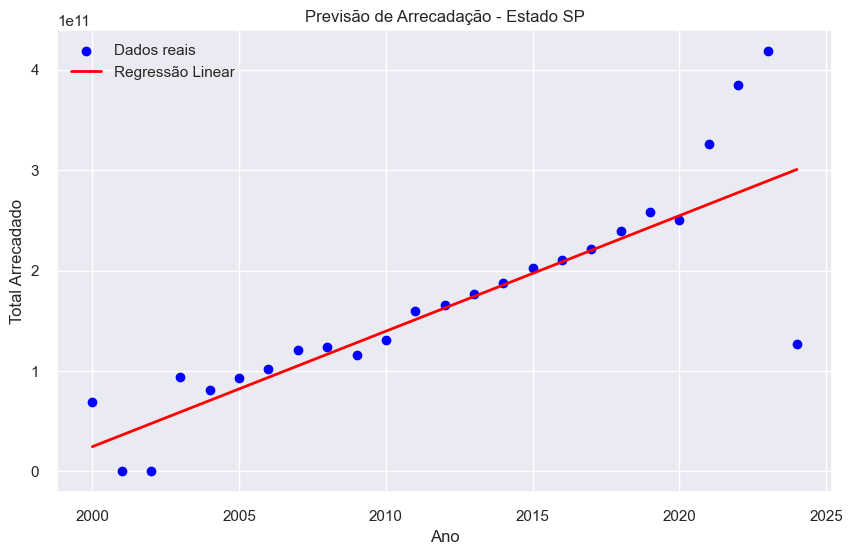

In [75]:

def previsao_arrecadacao_estado(estado):
    # Filtra os dados pelo estado
    dados_estado = dados[dados['UF'] == estado]

    # Agrupa os dados por ano para obter o total arrecadado por ano
    dados_agrupados = dados_estado.groupby('Ano')['TOTAL_ARRECADADO'].sum().reset_index()

    # Divisão dos dados em variáveis independentes e dependentes
    X = dados_agrupados[['Ano']]
    y = dados_agrupados['TOTAL_ARRECADADO']

    # Divisão dos dados em conjuntos de treino e teste
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Treinamento do modelo de Regressão Linear
    modelo = LinearRegression()
    modelo.fit(X_train, y_train)

    # Avaliação do modelo
    y_pred = modelo.predict(X_test)
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))

    print(f'Estatísticas do estado {estado}:')
    print(f'MAE: {mae}')
    print(f'RMSE: {rmse}')

    # Previsão para 2025
    ano_2025 = np.array([[2025]])
    previsao_2025 = modelo.predict(ano_2025)

    print(f'Previsão de arrecadação para 2025 no estado {estado}: {previsao_2025[0]}')

    # Plotando os resultados
    plt.figure(figsize=(10, 6))
    plt.scatter(X, y, color='blue', label='Dados reais')
    plt.plot(X, modelo.predict(X), color='red', linewidth=2, label='Regressão Linear')
    plt.xlabel('Ano')
    plt.ylabel('Total Arrecadado')
    plt.title(f'Previsão de Arrecadação - Estado {estado}')
    plt.legend()
    plt.show()

# Escolha o estado para prever a arrecadação (exemplo: 'SP' para São Paulo)
estado_escolhido = 'SP' 

previsao_arrecadacao_estado(estado_escolhido)

In [27]:
%pip install mglearn
%pip install yellowbrick

import mglearn



[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 282.6/282.6 kB 2.7 MB/s eta 0:00:00a 0:00:01

[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


# Agora Dividindo em Clusters

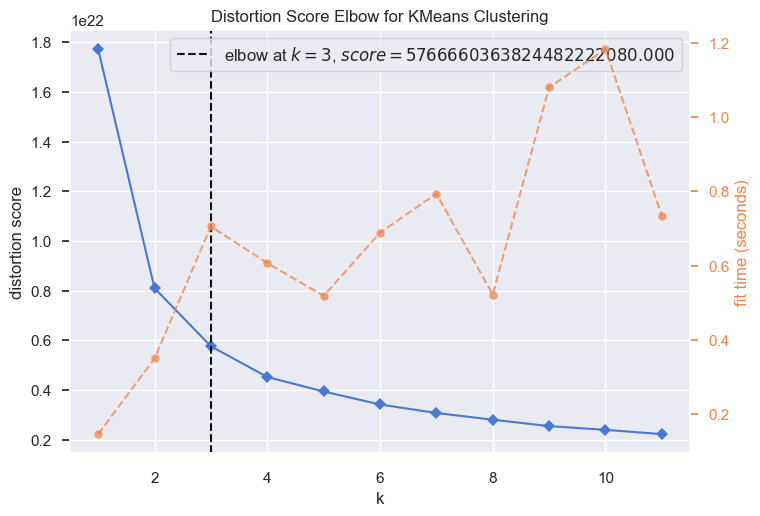

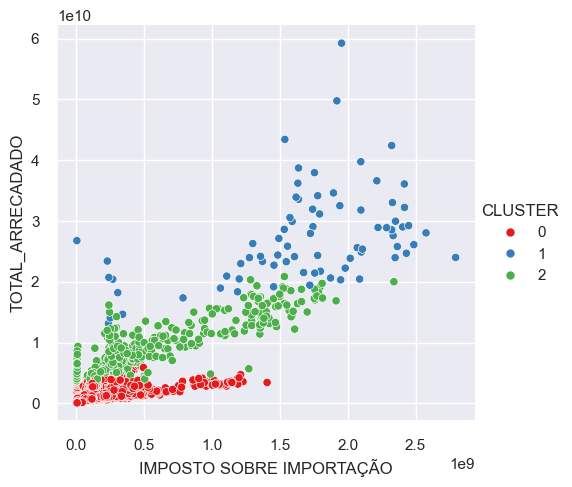

In [70]:
# Seleciona as colunas para o clustering
X = dados[colunas_numericas_ajustadas].fillna(0)

# Visualização Elbow para determinar o número ideal de clusters
kmeans = KMeans(init='k-means++', max_iter=300, n_init=10, random_state=0)
visualizer = KElbowVisualizer(kmeans, k=(1, 12))

visualizer.fit(X)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

# Obtem o número ideal de clusters
NUMBER_OF_CLUSTERS = visualizer.elbow_value_

# Aplica o KMeans com o número ótimo de clusters
kmeans = KMeans(n_clusters=NUMBER_OF_CLUSTERS, init='k-means++', max_iter=300, n_init=10, random_state=0)
kmeans.fit(X)

# Adiciona os clusters aos dados
dados['CLUSTER'] = kmeans.predict(X)

# Visualiza os clusters
sns.relplot(data=dados, x='IMPOSTO SOBRE IMPORTAÇÃO', y='TOTAL_ARRECADADO', hue='CLUSTER', palette='Set1')


# Modelo de classificação separado 3 categorias

/var/folders/pr/pwdqpc7d4vgdkqyjfzcgrv_r0000gq/T/ipykernel_25438/987542181.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Categoria', data=dados, palette='muted')


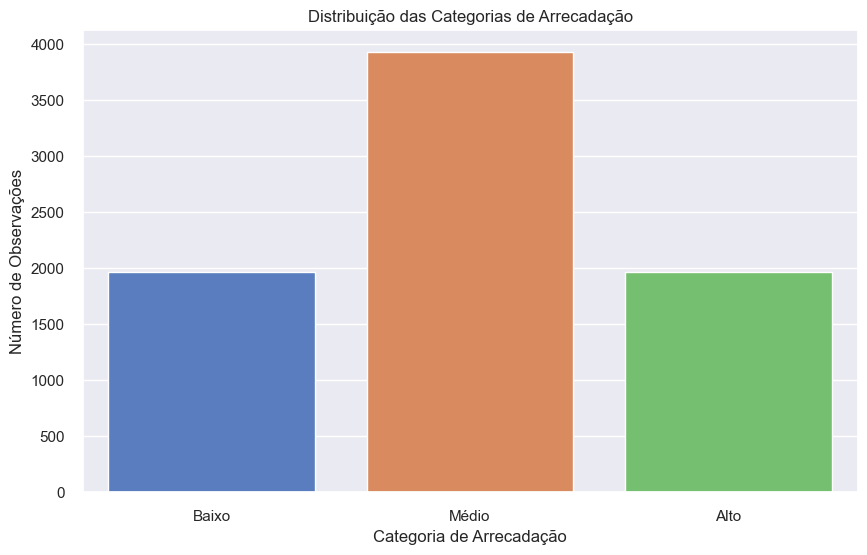

In [73]:
# Definir os percentis para categorização personalizada
percentis = [0, 0.25, 0.75, 1.0]  # Divisões em quartis, agora valores entre 0 e 1

# Calcular os percentis dos dados
percentis_valores = dados['TOTAL_ARRECADADO'].quantile(percentis)

# Definir os limites de cada categoria
categorias = ['Baixo', 'Médio', 'Alto']

# Função para categorizar os valores
def categorizar_valor(valor):
    if valor <= percentis_valores.iloc[1]:
        return categorias[0]
    elif valor <= percentis_valores.iloc[2]:
        return categorias[1]
    else:
        return categorias[2]

# Aplicar a categorização aos dados
dados['Categoria'] = dados['TOTAL_ARRECADADO'].apply(categorizar_valor)

# Visualização da distribuição das categorias
plt.figure(figsize=(10, 6))
sns.countplot(x='Categoria', data=dados, palette='muted')
plt.title('Distribuição das Categorias de Arrecadação')
plt.xlabel('Categoria de Arrecadação')
plt.ylabel('Número de Observações')
plt.show()